<h1>End-to-End Housing Prediction</h1>

## We will work on housing predictions ML project. We will start by:
<ul>
<li>Importing Libraries</li>
<li>Loading the data</li>
<li>Visualizing the data</li>
<li>Filling the missing values</li>
<li>Creating Pipelines</li>
<li>Handling Categorical Varibles</li>
<li>Training model based on data</li>
<li>Predicting using models</li>
</ul> 

## 1.Importing Libraries

In [1]:
import numpy as np
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import sklearn
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.model_selection import StratifiedShuffleSplit, cross_val_score, GridSearchCV
from pandas.plotting import scatter_matrix
from sklearn.impute import SimpleImputer
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error

import warnings
warnings.filterwarnings(action="ignore")

In [2]:
np.random.seed(42)

mpl.rc("axes",labelsize=15)
mpl.rc("xtick",labelsize=11)
mpl.rc("ytick", labelsize=11)

## 2.Loading the data

In [3]:
# Path of the datset
file="housing.csv"

# Read the CSV file
df=pd.read_csv(file)

#Displaying few rows from data
df.head()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity
0,-122.23,37.88,41.0,880.0,129.0,322.0,126.0,8.3252,452600.0,NEAR BAY
1,-122.22,37.86,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,358500.0,NEAR BAY
2,-122.24,37.85,52.0,1467.0,190.0,496.0,177.0,7.2574,352100.0,NEAR BAY
3,-122.25,37.85,52.0,1274.0,235.0,558.0,219.0,5.6431,341300.0,NEAR BAY
4,-122.25,37.85,52.0,1627.0,280.0,565.0,259.0,3.8462,342200.0,NEAR BAY


## 3. Exploring the data

In [4]:
# "info" to get data information
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20640 entries, 0 to 20639
Data columns (total 10 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   longitude           20640 non-null  float64
 1   latitude            20640 non-null  float64
 2   housing_median_age  20640 non-null  float64
 3   total_rooms         20640 non-null  float64
 4   total_bedrooms      20433 non-null  float64
 5   population          20640 non-null  float64
 6   households          20640 non-null  float64
 7   median_income       20640 non-null  float64
 8   median_house_value  20640 non-null  float64
 9   ocean_proximity     20640 non-null  object 
dtypes: float64(9), object(1)
memory usage: 1.6+ MB


In [5]:
# 'describe' to get statistical info
df.describe()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value
count,20640.000000,20640.000000,20640.000000,20640.000000,20433.000000,20640.000000,20640.000000,20640.000000,20640.000000
mean,-119.569704,35.631861,28.639486,2635.763081,537.870553,1425.476744,499.539680,3.870671,206855.816909
std,2.003532,2.135952,12.585558,2181.615252,421.385070,1132.462122,382.329753,1.899822,115395.615874
min,-124.350000,32.540000,1.000000,2.000000,1.000000,3.000000,1.000000,0.499900,14999.000000
25%,-121.800000,33.930000,18.000000,1447.750000,296.000000,787.000000,280.000000,2.563400,119600.000000
50%,-118.490000,34.260000,29.000000,2127.000000,435.000000,1166.000000,409.000000,3.534800,179700.000000
75%,-118.010000,37.710000,37.000000,3148.000000,647.000000,1725.000000,605.000000,4.743250,264725.000000
max,-114.310000,41.950000,52.000000,39320.000000,6445.000000,35682.000000,6082.000000,15.000100,500001.000000


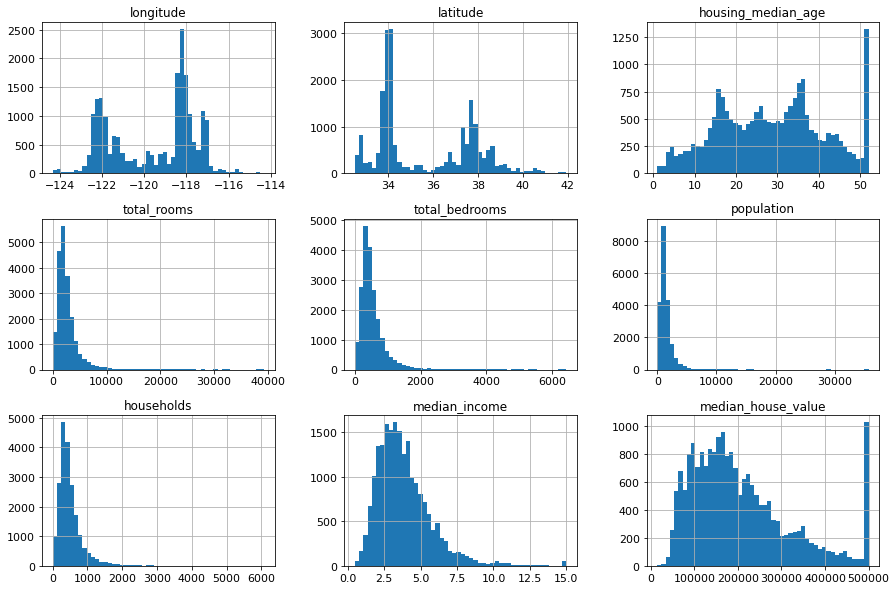

In [6]:
# Plotting data using histogram
df.hist(bins=50, figsize=(15, 10))
plt.show()

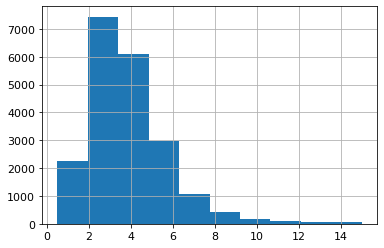

In [7]:
df['median_income'].hist()
plt.show() ##right skewed

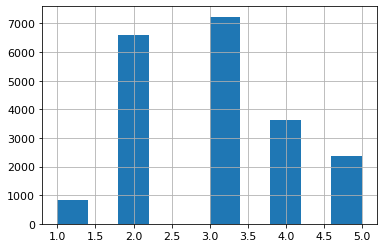

In [8]:
# Divide the median income into bins and labels using 'cut'
df["income_cut"]=pd.cut(df["median_income"],bins=[0.,1.5,3.0,4.5,6.,np.inf], labels=[1,2,3,4,5])

df["income_cut"].hist()
plt.show()

## 4. Splitting the data

In [9]:
# Dividing the dataset into 80-20
split=StratifiedShuffleSplit(n_splits=1, test_size=0.25, random_state=1)

for train_index, test_index in split.split(df, df["income_cut"]):
    strat_train_set=df.iloc[train_index]
    strat_test_set=df.iloc[test_index]

In [10]:
# Drop the 'income_cut' attribute from train and test set
for i in (strat_train_set, strat_test_set):
    i.drop("income_cut", axis=1,inplace=True)

In [11]:
# Creating copy on stratified_train_set
housing=strat_train_set.copy()

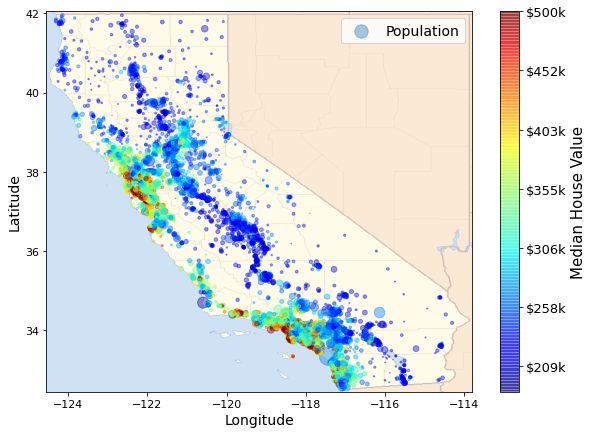

In [12]:
# Plotting scatter plot on california image
import matplotlib.image as mpimg
california_img=mpimg.imread('california.png')
ax = housing.plot(kind="scatter", x="longitude", y="latitude", figsize=(10,7),
                       s=housing['population']/100, label="Population",
                       c="median_house_value", cmap=plt.get_cmap("jet"),
                       colorbar=False, alpha=0.4,
                      )
plt.imshow(california_img, extent=[-124.55, -113.80, 32.45, 42.05], alpha=0.5,
           cmap=plt.get_cmap("jet"))
plt.ylabel("Latitude", fontsize=14)
plt.xlabel("Longitude", fontsize=14)

prices = housing["median_house_value"]
tick_values = np.linspace(prices.min(), prices.max(), 11)
cbar=plt.colorbar(ticks=tick_values/prices.max())
cbar.ax.set_yticklabels(["$%dk"%(round(v/1000)) for v in tick_values], fontsize=13)
cbar.set_label("Median House Value", fontsize=15)

plt.legend(loc="best", fontsize=14)
plt.show()

## 6. Creating a correlation matrix

In [13]:
housing["rooms_per_household"] = housing["total_rooms"]/housing["households"]
housing["bedrooms_per_room"] = housing["total_bedrooms"]/housing["total_rooms"]
housing["population_per_household"]=housing["population"]/housing["households"]

In [14]:
corr_matrix=housing.corr()

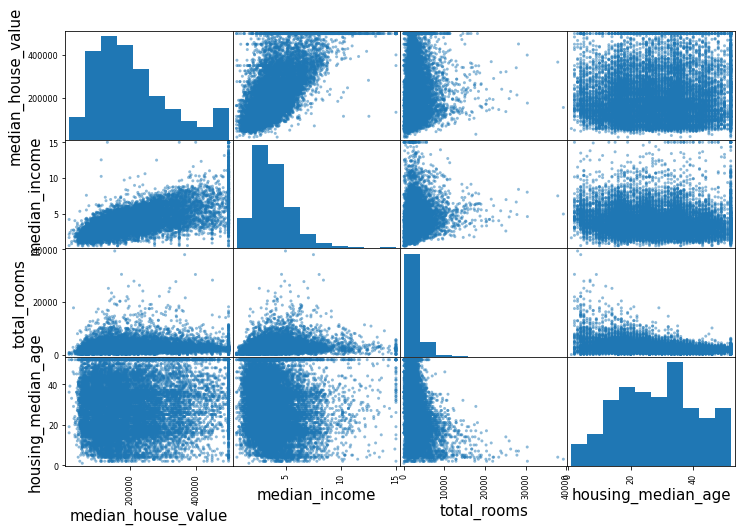

In [15]:
# Plot a scatter plot of all features
corr_matrix["median_house_value"].sort_values(ascending=False)

attributes = ["median_house_value", "median_income", "total_rooms", "housing_median_age"]
scatter_matrix(housing[attributes], figsize=(12, 8))
plt.show()

In [16]:
housing.describe()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,rooms_per_household,bedrooms_per_room,population_per_household
count,15480.000000,15480.000000,15480.000000,15480.000000,15317.000000,15480.000000,15480.000000,15480.000000,15480.000000,15480.000000,15317.000000,15480.000000
mean,-119.569159,35.630419,28.702713,2633.573708,537.278514,1423.973062,499.202326,3.871782,207052.896576,5.412897,0.212926,2.999360
std,2.003901,2.137502,12.599138,2189.599386,422.318252,1125.527295,382.563440,1.912249,115904.601412,2.263398,0.057562,5.238955
min,-124.300000,32.540000,1.000000,6.000000,1.000000,3.000000,1.000000,0.499900,14999.000000,0.888889,0.100000,0.692308
25%,-121.800000,33.930000,18.000000,1444.000000,295.000000,785.000000,279.000000,2.563975,119900.000000,4.445583,0.175373,2.432164
50%,-118.490000,34.260000,29.000000,2118.000000,433.000000,1163.000000,408.000000,3.531300,179750.000000,5.227585,0.203162,2.824407
75%,-118.010000,37.710000,37.000000,3137.000000,645.000000,1724.250000,602.000000,4.742600,265000.000000,6.058512,0.239711,3.286276
max,-114.310000,41.950000,52.000000,39320.000000,6210.000000,35682.000000,5358.000000,15.000100,500001.000000,141.909091,1.000000,599.714286


## 7. Fill the missing values

In [18]:
housing=strat_train_set.drop("median_house_value", axis=1)

# Store the label in variable
housing_labels=strat_train_set["median_house_value"].copy()

imputer=SimpleImputer(strategy="median")

housing_num=housing.drop("ocean_proximity", axis=1)

imputer.fit(housing_num)

X=imputer.transform(housing_num)
housing_tr=pd.DataFrame(X, columns=housing_num.columns, index=housing.index)

## 8. Handling Categorical attributes

In [20]:
housing_cat = housing[["ocean_proximity"]]

cat_encoder = OneHotEncoder()
housing_cat_1hot = cat_encoder.fit_transform(housing_cat)
housing_cat_1hot

<15480x5 sparse matrix of type '<class 'numpy.float64'>'
	with 15480 stored elements in Compressed Sparse Row format>

In [21]:
housing_cat_1hot.toarray()

array([[1., 0., 0., 0., 0.],
       [0., 0., 0., 0., 1.],
       [0., 1., 0., 0., 0.],
       ...,
       [1., 0., 0., 0., 0.],
       [0., 0., 0., 1., 0.],
       [1., 0., 0., 0., 0.]])

## 9. Creating a custom Transformer

In [22]:
rooms_ix, bedrooms_ix, population_ix, households_ix = 3, 4, 5, 6

class CombinedAttributesAdder(BaseEstimator, TransformerMixin):
    def __init__(self, add_bedrooms_per_room=True):
        self.add_bedrooms_per_room = add_bedrooms_per_room
    def fit(self, X, y=None):
        return self
    def transform(self, X):
        rooms_per_household = X[:, rooms_ix] / X[:, households_ix]
        population_per_household = X[:, population_ix] / X[:, households_ix]
        if self.add_bedrooms_per_room:
            bedrooms_per_room = X[:, bedrooms_ix] / X[:, rooms_ix]
            return np.c_[X, rooms_per_household, population_per_household,
                         bedrooms_per_room]
        else:
            return np.c_[X, rooms_per_household, population_per_household]

attr_adder = CombinedAttributesAdder(add_bedrooms_per_room=False)
housing_extra_attribs = attr_adder.transform(housing.values)

## 10. Creating transformation pipelines

In [23]:
col_names = "total_rooms", "total_bedrooms", "population", "households"
rooms_ix, bedrooms_ix, population_ix, households_ix = [
    housing.columns.get_loc(c) for c in col_names]

housing_extra_attribs = pd.DataFrame(
    housing_extra_attribs,
    columns=list(housing.columns)+["rooms_per_household", "population_per_household"],
    index=housing.index)
housing_extra_attribs.head()

from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler

num_pipeline = Pipeline([
        ('imputer', SimpleImputer(strategy="median")),
        ('attribs_adder', CombinedAttributesAdder()),
        ('std_scaler', StandardScaler()),
    ])

housing_num_tr = num_pipeline.fit_transform(housing_num)

from sklearn.compose import ColumnTransformer

num_attribs = list(housing_num)
cat_attribs = ["ocean_proximity"]

full_pipeline = ColumnTransformer([
        ("num", num_pipeline, num_attribs),
        ("cat", OneHotEncoder(), cat_attribs),
    ])


housing_prepared = full_pipeline.fit_transform(housing)

## 11. Train a Decision Tree model

In [24]:
tree_reg = DecisionTreeRegressor(random_state=42)
tree_reg.fit(housing_prepared, housing_labels)

# Predicting the model
housing_predictions = tree_reg.predict(housing_prepared)

# Evaluating the model
tree_mse = mean_squared_error(housing_labels, housing_predictions)
tree_rmse = np.sqrt(tree_mse)
tree_rmse

0.0

## 12. Train a Random Forest model

In [26]:
forest_reg = RandomForestRegressor(n_estimators=100, random_state=42)
forest_reg.fit(housing_prepared, housing_labels)

housing_predictions = forest_reg.predict(housing_prepared)

forest_mse = mean_squared_error(housing_labels, housing_predictions)
forest_rmse = np.sqrt(forest_mse)
forest_rmse

18774.717668442103

## 13. Fine tune your model with Cross Validation

In [28]:
def display_scores(scores):
    print("Scores:", scores)
    print("Mean:", scores.mean())
    print("Standard deviation:", scores.std())

In [29]:
scores = cross_val_score(tree_reg, housing_prepared, housing_labels,
                         scoring="neg_mean_squared_error", cv=10)
tree_rmse_scores = np.sqrt(-scores)
display_scores(tree_rmse_scores)

Scores: [73900.14901079 75010.70144869 69095.87712611 72323.28615548
 70472.29023067 68591.36079626 70728.54513427 69920.56628568
 71930.98675173 74326.58263954]
Mean: 71630.03455792293
Standard deviation: 2124.9870308658137


In [30]:
forest_scores = cross_val_score(forest_reg, housing_prepared, housing_labels,
                                scoring="neg_mean_squared_error", cv=10)
forest_rmse_scores = np.sqrt(-forest_scores)
display_scores(forest_rmse_scores)

Scores: [51165.62850244 54036.54789939 46291.80792235 51020.28536043
 52304.3982068  46068.41938156 48011.27327619 50675.03449813
 53809.72704822 52149.14271131]
Mean: 50553.22648068206
Standard deviation: 2714.6749611667287


## 14. Fine tune your model with Grid Search

In [31]:
param_grid = [
    {'n_estimators': [3, 10, 30], 'max_features': [2, 4, 6, 8]},
    {'bootstrap': [False], 'n_estimators': [3, 10], 'max_features': [2, 3, 4]},
  ]

In [32]:
forest_reg = RandomForestRegressor(random_state=42)
grid_search = GridSearchCV(forest_reg, param_grid, cv=5,
                           scoring='neg_mean_squared_error',
                           return_train_score=True)
grid_search.fit(housing_prepared, housing_labels)

GridSearchCV(cv=5, estimator=RandomForestRegressor(random_state=42),
             param_grid=[{'max_features': [2, 4, 6, 8],
                          'n_estimators': [3, 10, 30]},
                         {'bootstrap': [False], 'max_features': [2, 3, 4],
                          'n_estimators': [3, 10]}],
             return_train_score=True, scoring='neg_mean_squared_error')

In [33]:
# Best combination of parameters
grid_search.best_params_

{'max_features': 8, 'n_estimators': 30}

In [34]:
# Best combination of estimators
grid_search.best_estimator_

RandomForestRegressor(max_features=8, n_estimators=30, random_state=42)

In [35]:
cvres = grid_search.cv_results_
for mean_score, params in zip(cvres["mean_test_score"], cvres["params"]):
    print(np.sqrt(-mean_score), params)

65302.696216599834 {'max_features': 2, 'n_estimators': 3}
56367.90977194547 {'max_features': 2, 'n_estimators': 10}
53590.598971828025 {'max_features': 2, 'n_estimators': 30}
60434.569086812866 {'max_features': 4, 'n_estimators': 3}
52958.86928693305 {'max_features': 4, 'n_estimators': 10}
50526.35116582593 {'max_features': 4, 'n_estimators': 30}
59355.57403512911 {'max_features': 6, 'n_estimators': 3}
52509.54138127331 {'max_features': 6, 'n_estimators': 10}
50425.73292876691 {'max_features': 6, 'n_estimators': 30}
59318.153551304385 {'max_features': 8, 'n_estimators': 3}
52737.95237850787 {'max_features': 8, 'n_estimators': 10}
50412.49532074722 {'max_features': 8, 'n_estimators': 30}
62962.552340993185 {'bootstrap': False, 'max_features': 2, 'n_estimators': 3}
55040.92667540899 {'bootstrap': False, 'max_features': 2, 'n_estimators': 10}
60029.7150710231 {'bootstrap': False, 'max_features': 3, 'n_estimators': 3}
52973.57346960467 {'bootstrap': False, 'max_features': 3, 'n_estimators'

## 15. Analyze and evaluate best model

In [36]:
final_model = grid_search.best_estimator_

X_test = strat_test_set.drop("median_house_value", axis=1)
y_test = strat_test_set["median_house_value"].copy()

X_test_prepared = full_pipeline.transform(X_test)

final_predictions = final_model.predict(X_test_prepared)

final_mse = mean_squared_error(y_test, final_predictions)
final_rmse = np.sqrt(final_mse)
final_rmse

47607.0980385168